<a href="https://colab.research.google.com/github/gabrielv69/AbnormalDetection/blob/main/FinalVersionDetection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**IMPORTACIONES**

In [ ]:
!pip install scikit-video
!pip install classifier

     |████████████████████████████████| 2.3 MB 34.2 MB/s 
     |████████████████████████████████| 64 kB 2.9 MB/s 
  Created wheel for classifier: filename=classifier-2.0-py3-none-any.whl size=5055 sha256=d5c802b5817dce07d00703dc88652605ada2f637767da5ab64070f0d30d1e860
  Stored in directory: /root/.cache/pip/wheels/87/ea/b6/d1ee201ef021c46f0ae8f1d29bf6e6d039807dfa521a092d5d
Successfully built classifier


In [ ]:
import os
import cv2
import scipy
import theano
import numpy as np
import skvideo.io
import classifier
import pandas as pd
import keras.optimizers
import scipy.io as sio
from PIL import Image
import keras.backend as K
import theano.tensor as T
import matplotlib
matplotlib.use('Agg')
from sklearn import metrics
import sklearn.preprocessing
import matplotlib.pyplot as plt
from keras.regularizers import l2
#from scipy.misc import imresize
from keras.models import Sequential
from keras.models import load_model
from keras.utils.data_utils import get_file
from matplotlib.animation import FuncAnimation
from keras.models import Model, model_from_json
#from keras.optimizers import Adagrad # - Works
import tensorflow
from keras.layers.core import Dense, Dropout, Flatten
from keras.layers.convolutional import Conv3D, MaxPooling3D, ZeroPadding3D

**EXTRACCIÓN DE CARACTERÍSTICAS**

In [ ]:
def C3D(weights='sports1M'):
  '''Estructura y carga de los pesos del modelo C3D'''
  shape= (16, 112, 112,3) if K.image_data_format() == 'channels_last' else (3, 16, 112, 112)
  model = Sequential()
  model.add(Conv3D(64, 3, activation='relu', padding='same', name='conv1', input_shape=shape))
  model.add(MaxPooling3D(pool_size=(1,2,2), strides=(1,2,2), padding='same', name='pool1'))
  model.add(Conv3D(128, 3, activation='relu', padding='same', name='conv2'))
  model.add(MaxPooling3D(pool_size=(2,2,2), strides=(2,2,2), padding='valid', name='pool2'))
  model.add(Conv3D(256, 3, activation='relu', padding='same', name='conv3a'))
  model.add(Conv3D(256, 3, activation='relu', padding='same', name='conv3b'))
  model.add(MaxPooling3D(pool_size=(2,2,2), strides=(2,2,2), padding='valid', name='pool3'))
  model.add(Conv3D(512, 3, activation='relu', padding='same', name='conv4a'))
  model.add(Conv3D(512, 3, activation='relu', padding='same', name='conv4b'))
  model.add(MaxPooling3D(pool_size=(2,2,2), strides=(2,2,2), padding='valid', name='pool4'))
  model.add(Conv3D(512, 3, activation='relu', padding='same', name='conv5a'))
  model.add(Conv3D(512, 3, activation='relu', padding='same', name='conv5b'))
  model.add(ZeroPadding3D(padding=(0,1,1)))
  model.add(MaxPooling3D(pool_size=(2,2,2), strides=(2,2,2), padding='valid', name='pool5')) 

  model.add(Flatten())
  model.add(Dense(4096, activation='relu', name='fc6'))#Capa de extracción
  model.add(Dropout(0.5))
  model.add(Dense(4096, activation='relu', name='fc7'))
  model.add(Dropout(0.5))
  model.add(Dense(487, activation='softmax', name='fc8'))   

  if weights == 'sports1M':
    c3d_model_weights = '/content/drive/MyDrive/AnomalyD/sports1M_weights_tf.h5'
    model.load_weights(c3d_model_weights)

  return model

def featureExtractorModel():
  '''Retorna el modelo extractor basado en el modelo C3D de Facebook'''
  model = C3D()
  layer_name = 'fc6'
  extractorModel = Model(inputs=model.input, outputs=model.get_layer(layer_name).output)
  return extractorModel

In [ ]:
#Procesamiento Video
def readVideo(video_path): 
  '''Retorna un arreglo con los frames del video'''
  cap = cv2.VideoCapture(video_path) #Creación de un objeto de captura
  frames = []
  while (cap.isOpened()):
    ret, frame = cap.read()  #Lectura del video frame por frame
    if ret:
      frame = cv2.resize(frame, (250,250)) # Se hace un resize inicial al leer el video
      frames.append(frame)   
    else:
      break   #Fin del video
  cap.release() #Liberamos recursos
  return frames 

def splitVideo(arr, size=16, stride=16):
  '''Retorna un npArray con bags de  un mismo tamaño de frames'''
  numBags = int((len(arr) - size) / stride) + 2 #Número de pedazos de tamaño = size dentro del video
  bags = []
  for i in range(0,  numBags * size, stride):#(start,end,step)
    if len(arr[i:i + size])==16: #Solo bags de tamaño justo
      bags.append(arr[i:i + size])
  return np.array(bags)

def videoClips(video_path):
  '''Retorna los clips (bags) y número total de frames del video'''
  sizeBag=16
  frames = readVideo(video_path)
  clips = splitVideo(frames, sizeBag, sizeBag)
  return clips, len(frames)

def preprocessClip(clip):
  """Resize del clip y se le resta el mean de CD3"""
  reshape_clips = np.zeros((clip.shape[0], 128, 171, clip.shape[3]))# Reshape 128x171
  for i, img in enumerate(clip):
    img = np.array(Image.fromarray(img).resize(size=(171, 128),resample= 3)) #(w,h) 'PIL.Image.BICUBIC'
    reshape_clips[i,:,:,:] = img 
  C3D_MEAN_PATH= '/content/drive/MyDrive/AnomalyD/c3d_mean.npy'
  mean = np.load(C3D_MEAN_PATH)  
  reshape_clips -= mean # Restar el mean de CD3
  reshape_clips = reshape_clips[:,8:120,30:142,:] # Cortar  a 112x112 pa el modelo de CD3 
  reshape_clips = np.expand_dims(reshape_clips, axis=0)  # Add extra dimension for samples
  return reshape_clips

Pre-procesamiento de los videos

In [ ]:
'''Procesamiento de los videos para extraer las características y almacenarlas como archivos npy'''
extractorModel = featureExtractorModel()
nameFile= 'normal.txt' #Archivo donde se guardarán los nombres de los videos, num Frames y si es Anormal o no 
pathVideos= '/content/videos'
destino = '/content/destine'
boolAnormal=0
with open(nameFile, 'w') as f:
  for video in os.listdir(pathVideos):
    videoName = video.split('.')[0] #Obtener el nombre del vídeo 
    videoPath=os.path.join(pathVideos,video)
    clips, numFrames = videoClips(videoPath)
    f.write(video+'\t'+str(numFrames)+'\t'+str(boolAnormal)+'\n') #String a almacenar en el file
    clipsPreprocesados = [preprocessClip(np.array(clip)) for clip in clips] #Preproceso cada cilp (resize)
    clipsPreprocesados = np.vstack(clipsPreprocesados)#Convierto prepclips en np array de una dimensión
    features = extractorModel(clipsPreprocesados)#Cada clip(16 frames) se pasa al modelo de extraccion
    print(features.shape)
    #features = sklearn.preprocessing.normalize(features, axis=1, copy=False) #Normalizo el nparray
    featsPath = os.path.join(destino, videoName+".npy") #Nombre del npy
    np.save(featsPath,features)
f.close()

In [ ]:
#Descomprimo los NPY de los características de los videos
import zipfile
with zipfile.ZipFile('/content/drive/MyDrive/AnomalyD/NPYAN.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/Datanpy')

**MODELO CLASIFICADOR**

In [ ]:
def loadBatch(batchSize):
  '''Retorna las características y las etiquetas a nivel de bag que formarán los batch con los cuales
  se entrenará el modelo clasificador '''
  pathNormal = '/content/Datanpy/Normales'
  pathAnormal= '/content/Datanpy/Anormales'
  batchSize=12
  midBatch = int(batchSize/2)
  ListOfVideos = np.random.permutation(76) #75 Videos por categoría para entrenamiento
  batchVideos = ListOfVideos[:midBatch] #Tomo solo el número dependiendo del batch que requiero
  #Archivos que contienen los nombres de los videos previamente almacenados como características
  contentNormal = pd.read_csv('/content/drive/MyDrive/AnomalyD/normal(1).txt', header=None,sep="\t")
  contentAbnormal = pd.read_csv('/content/drive/MyDrive/AnomalyD/anormal(4).txt', header=None,sep="\t")
  abnormalFeats = []
  normalFeats = []
  numLabelsA= 0 #Número de etiquetas  Anormales (bags) del batch
  for videoIndice in batchVideos:
    videoNormal = contentNormal[0][videoIndice]+ ".npy"
    pathVideoNormal= os.path.join(pathNormal,videoNormal)
    videoAbnormal = contentAbnormal[0][videoIndice]+ ".npy"
    pathVideoANormal= os.path.join(pathAnormal,videoAbnormal)
    with open(pathVideoANormal, "rb") as f:
      featsA = np.load(f) #Leo el npy
      numLabelsA=numLabelsA+featsA.shape[0] #Se suma el tamaño del bag leído para obtener el total
    abnormalFeats.append(featsA)
    with open(pathVideoNormal, "rb") as g:
      featsN = np.load(g) #Leo el npy
    normalFeats.append(featsN)
  allFeats = np.vstack((*abnormalFeats, *normalFeats)) #Junto las características anormales y normales en un un solo NpArray
  allLabels = np.zeros(allFeats.shape[0], dtype='int8') #Array con las etiquetas inicialmente con valor 0 (Normal)
  allLabels[:numLabelsA] = 1 #Se pone valor 1 a las etiquetas de los bags Anormales
  return  allFeats, allLabels

In [ ]:
def custom_objective(y_true, y_pred):
  y_true = K.reshape(y_true, [-1])
  y_pred = K.reshape(y_pred, [-1])
  n_seg = 80 #El número de segmentos por video en promedio 
  nvid = 12
  n_exp = int(nvid / 2)
  max_scores_list = []
  z_scores_list = []
  temporal_constrains_list = []
  sparsity_constrains_list = []

  for i in range(0, n_exp, 1):
    video_predictions = y_pred[i*n_seg:(i+1)*n_seg]
    max_scores_list.append(K.max(video_predictions))
    temporal_constrains_list.append(K.sum(K.pow(video_predictions[1:] - video_predictions[:-1], 2)))
    sparsity_constrains_list.append(K.sum(video_predictions))

  for j in range(n_exp, 2*n_exp, 1):
    video_predictions = y_pred[j*n_seg:(j+1)*n_seg]
    max_scores_list.append(K.max(video_predictions))

  max_scores = K.stack(max_scores_list)
  temporal_constrains = K.stack(temporal_constrains_list)
  sparsity_constrains = K.stack(sparsity_constrains_list)

  for ii in range(0, n_exp, 1):
    max_z = K.maximum(1 - max_scores[:n_exp] + max_scores[n_exp+ii], 0)
    z_scores_list.append(K.sum(max_z))

  z_scores = K.stack(z_scores_list)
  z = K.mean(z_scores)

  return z + \
  0.00008*K.sum(temporal_constrains) + \
  0.00008*K.sum(sparsity_constrains)  #Pérdida final

In [ ]:
def classifierModel():
  model = Sequential()
  model.add(Dense(512, input_dim=4096, kernel_initializer='glorot_normal',kernel_regularizer=l2(0.001), activation='relu'))
  model.add(Dropout(0.5))
  model.add(Dense(80, kernel_initializer='glorot_normal',kernel_regularizer=l2(0.001)))
  model.add(Dropout(0.5))
  model.add(Dense(1, kernel_initializer='glorot_normal',kernel_regularizer=l2(0.001), activation='sigmoid'))
  adagrad=tensorflow.keras.optimizers.Adagrad(learning_rate=0.01, epsilon=1e-08)
  model.compile( optimizer=adagrad, loss=custom_objective)
  return model

**ENTRENAMIENTO DEL MODELO**

In [ ]:
model = classifierModel()
model.summary()
iteraciones = 600
batchSize=12
numIterations=0
for it in range(iteraciones):
  inputs, targets = loadBatch(batchSize)
  batchLoss = model.train_on_batch(x=inputs, y=targets) #Single gradient update or model evaluation over one batch of samples.
  numIterations += 1
  if numIterations % 10 == 0:
    print("Iteration={}, loss: {}".format(numIterations, batchLoss))

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 512)               2097664   
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 80)                41040     
                                                                 
 dropout_1 (Dropout)         (None, 80)                0         
                                                                 
 dense_2 (Dense)             (None, 1)                 81        
                                                                 
Total params: 2,138,785
Trainable params: 2,138,785
Non-trainable params: 0
_________________________________________________________________
Iteration=10, loss: 3.0721442699432373
Iterati

In [ ]:
model.save('my_model.h5')  # creates a HDF5 file 'my_model.h5'

**TESTEO DEL MODELO**

In [ ]:
def testeo(modelPath,predFolder):
  model = load_model(modelPath, custom_objects={"custom_objective": custom_objective}) #Cargamos el modelo entrenado
  model.summary()
  #Carpetas que contienen las características de los videos a testear y los archivos que contiene los nombres
  pathNormal = '/content/Datanpy/Normales'
  pathAnormal= '/content/Datanpy/Anormales'
  contentNormal = pd.read_csv('/content/drive/MyDrive/AnomalyD/normal(1).txt', header=None,sep="\t")
  contentAbnormal = pd.read_csv('/content/drive/MyDrive/AnomalyD/anormal(4).txt', header=None,sep="\t")
  for videoIndice in range(76,105): # 30 videos por categoría para entrenamiento
    videoNormal = contentNormal[0][videoIndice]+ ".npy"
    videoAnormal = contentAbnormal[0][videoIndice]+ ".npy"
    pathVideoNormal= os.path.join(pathNormal,videoNormal)
    pathVideoAnormal= os.path.join(pathAnormal,videoAnormal)
    for aux in range(2):
      videoPath= pathVideoNormal if aux==0 else pathVideoAnormal
      fileName = videoNormal if aux==0 else videoAnormal
      with open(videoPath, "rb") as f:
        feats = np.load(f)
      prediction = model.predict_on_batch(feats)
      predPath= os.path.join(predFolder,fileName)
      with open(predPath, "wb") as h:
        np.save(predPath, prediction, allow_pickle=True)

In [ ]:
predFolder = '/content/predicciones' #Carpeta donde se almacenarán las predicciones realizadas por el modelo
modelPath= '/content/my_model.h5'
testeo(modelPath,predFolder)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 512)               2097664   
                                                                 
 dropout_2 (Dropout)         (None, 512)               0         
                                                                 
 dense_4 (Dense)             (None, 80)                41040     
                                                                 
 dropout_3 (Dropout)         (None, 80)                0         
                                                                 
 dense_5 (Dense)             (None, 1)                 81        
                                                                 
Total params: 2,138,785
Trainable params: 2,138,785
Non-trainable params: 0
_________________________________________________________________


**EVALUACIÓN DEL MODELO**

In [ ]:
#Permite plotear en colab
%matplotlib inline 

In [ ]:
def calculateEER(fpr, tpr, thr):
  '''Retorna el EER'''
  fnr = 1-tpr
  # the threshold of fnr == fpr
  eer_threshold = thr[np.nanargmin(np.absolute((fnr - fpr)))]
  # theoretically eer from fpr and eer from fnr should be identical but they can be slightly differ in reality
  eer_1 = fpr[np.nanargmin(np.absolute((fnr - fpr)))]
  eer_2 = fnr[np.nanargmin(np.absolute((fnr - fpr)))]
  # return the mean of eer from fpr and from fnr
  eer = (eer_1 + eer_2) / 2
  return eer

In [ ]:
def extrapolate(outputs):
  '''Extrapola las predicciones a nivel de frames'''
  outputsNumberFrames = []
  for indx in range(len(outputs)):
    for value in range(16):
      outputsNumberFrames.append(outputs[indx])
  return np.array(outputsNumberFrames)

In [ ]:
#Listas que contendrán los y_true & y_pred a nivel de video, bags y frames
predsTotalesBags = []
predsTotalesFrames = []
predsTotalesVideos=[]
trueBagsTotal =[]
trueFramesTotal=[]
trueVideosTotal=[]
predFolder = '/content/predicciones'
output_folder= '/content/images'
for video in os.listdir(predFolder):
  predsFilePath = os.path.join(predFolder,video)
  result = video.find('Normal') #Para saber si el video es normal o abnormal
  with open(predsFilePath, "rb") as f:
    preds = np.load(f)
  numBags= int(preds.shape[0]) #Número de bags de cada video
  predPerFrame = extrapolate(preds) #Predicciones a nivel de frame
  numFrames= int(preds.shape[0]*16)#Número de Frames por video
  #Si el file contiene Normal se espera que todos sean valor 0, caso contrario debe ser 1 de Anormal
  trueBags= np.zeros(numBags) if result==0 else np.ones(numBags) 
  trueFrames =np.zeros(numFrames) if result==0 else np.ones(numFrames)
  
  roundPreds= np.round(preds) #Redondeo para tener valores 0 o 1
  predVideo= 1 if 1 in roundPreds else 0 #Si al menos un bag es anormal todo el video es anormal
  trueVideo = 1 if result == -1 else 0 #Si contiene la palabra normal es normal el video completo
  #y_true & y_pred a nivel BAG
  trueBagsTotal.append(trueBags)
  predsTotalesBags.append(preds)

  #y_true & y_pred a nivel FRAME
  trueFramesTotal.append(trueFrames)
  predsTotalesFrames.append(predPerFrame)

  #y_true & y_pred a nivel VIDEO
  trueVideosTotal.append(trueVideo)
  predsTotalesVideos.append(predVideo)

trueVideosTotalNP= np.array(trueVideosTotal)
predsTotalesVideosNP=np.array(predsTotalesVideos)

In [ ]:
def metricas(y_true,y_pred,needConcanate=True):
  if needConcanate:
    esperadoTotal = np.concatenate(y_true) #Se ponen las predicciones en un solo eje para tener un arreglo de una dimensión
    predsTotales = np.concatenate(y_pred) #Se ponen las predicciones en un solo eje para tener un arreglo de una dimensión
    predsTotales = np.concatenate(predsTotales)
    etiquetasPredicciones = np.round(predsTotales) #Mayores de 0.5 se considera como anomalía
  else:
    esperadoTotal= y_true
    predsTotales = y_pred
    etiquetasPredicciones= y_pred
  
  print(esperadoTotal.shape)
  print(predsTotales.shape)
  print(etiquetasPredicciones.shape)

  #MÉTRICAS
  accuracy = metrics.accuracy_score(esperadoTotal, etiquetasPredicciones) #Accuracy classification score
  aps = metrics.average_precision_score(esperadoTotal, predsTotales) # average precision (AP) score
  f1 = metrics.f1_score(esperadoTotal, etiquetasPredicciones,average='binary') #F-score or F-measure.
  fpr, tpr, thr = metrics.roc_curve(esperadoTotal, predsTotales) #Receiver operating characteristic (ROC)
  eer= calculateEER(fpr, tpr, thr) #Equal error rate (EER)
  prec, rec, _ = metrics.precision_recall_curve(esperadoTotal, predsTotales) #Compute precision-recall pairs for different probability thresholds
  confusionMatrix = metrics.confusion_matrix(esperadoTotal, etiquetasPredicciones) #Confusion matrix to evaluate the accuracy of a classification.
  auc = metrics.auc(fpr, tpr) #Area Under the Curve (AUC) using the trapezoidal rule.

  print("Accuracy: {:.5f}, AUC: {:.5f}, F1: {:.5f}, EER: {:.5f}, AP: {:.5F}".format(accuracy, auc, f1, eer, aps))
  print("Confusion matrix")
  print(confusionMatrix)

  plt.figure(figsize=(8,12))
  plt.title("Curva ROC")
  plt.subplot(2, 1, 1) # (rows, columns, panel number)
  plt.ylabel('True Positive Rate')
  plt.xlabel('False Positive Rate')
  plt.plot(fpr, tpr, 'b', label = "AUC: {}".format(auc))
  plt.legend(loc = 'lower right')
  plt.plot([0, 1], [0, 1],'r--')

  plt.subplot(2, 1, 2) # (rows, columns, panel number)
  plt.title("Curva PR")
  plt.plot(rec, prec, 'g', label = "Original - AP: {:.5f}".format(aps))
  plt.legend(loc = 'lower right')
  plt.ylabel('Precison')
  plt.xlabel('Recall')


A NIVEL DE FRAMES

(75456,)
(75456,)
(75456,)
Accuracy: 0.69975, AUC: 0.88345, F1: 0.58131, EER: 0.20738, AP: 0.87969
Confusion matrix
[[37072   960]
 [21696 15728]]


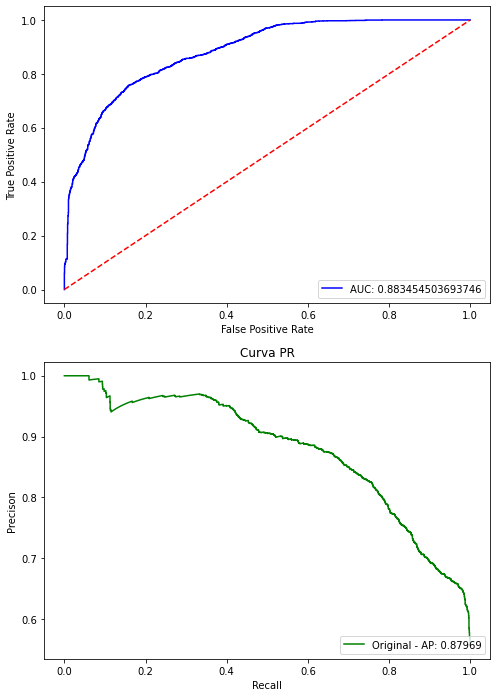

In [ ]:
metricas(trueFramesTotal,predsTotalesFrames)

A NIVEL DE BAGS

(4716,)
(4716,)
(4716,)
Accuracy: 0.69975, AUC: 0.88345, F1: 0.58131, EER: 0.20738, AP: 0.87969
Confusion matrix
[[2317   60]
 [1356  983]]


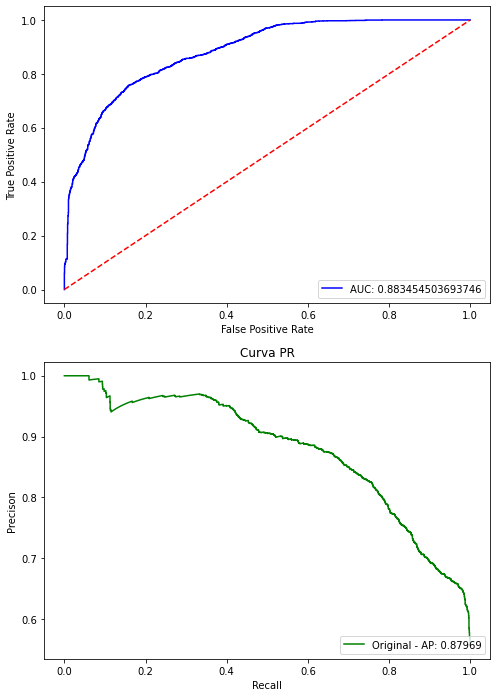

In [ ]:
metricas(trueBagsTotal,predsTotalesBags)

A NIVEL DE VIDEO

(58,)
(58,)
(58,)
Accuracy: 0.86207, AUC: 0.86207, F1: 0.86207, EER: 0.13793, AP: 0.81213
Confusion matrix
[[25  4]
 [ 4 25]]


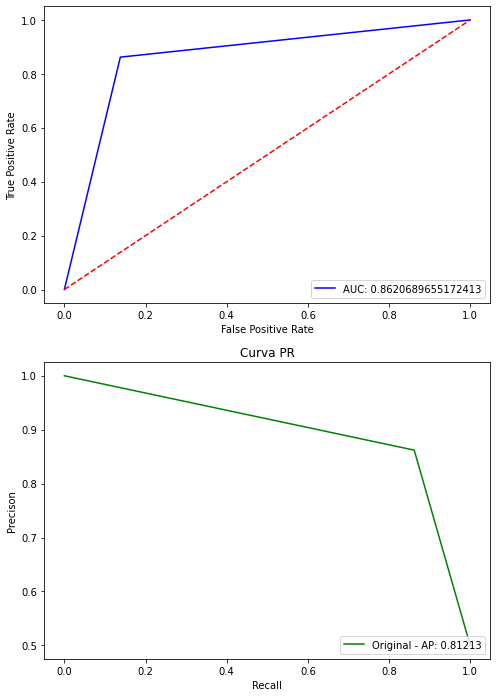

In [ ]:
metricas(trueVideosTotalNP,predsTotalesVideosNP,needConcanate=False)

**REALIZAR NUEVAS PREDCCIONES**

In [ ]:
def visualizePredictions(videoPath, predictions,outputFolder):
  '''Genera un gif donde la imagen se actualiza cada 8 frames y muestra la predicciones a nivel de frames'''
  videoName = os.path.basename(videoPath).split('.')[0]
  frames = readVideo(videoPath) #Obtención de los frames del video
  fig, _= plt.subplots(figsize=(7, 7))
  #fig.set_tight_layout(True)
  plotSuperior = plt.subplot(2, 1, 1)
  img = plotSuperior.imshow(frames[0]) #En la parte superior se monstrará el video
  fig.suptitle(videoName, fontsize=10)
  plotInferior = plt.subplot(2, 1, 2)
  #Se establecen los ejes y los datos que se mostrará en el subplot  inferior siendo estos las predicciones 
  plotInferior.set_xlim(0, len(predictions)) 
  plotInferior.set_ylim(0, 1.05)
  line = matplotlib.lines.Line2D([], [])#Serán los datos que serán mostrados
  plotInferior.add_line(line)

  def update(i):
    '''Retorna el plot que se actualizará con nuevos frames y respectivas predicciones'''
    frame = frames[i]
    x = range(0, i)
    y = predictions[0:i]
    line.set_data(x, y)
    img.set_data(frame)
    return plt

  anim = FuncAnimation(fig, update, frames=np.arange(0, len(predictions), 4)) #Se actualiza la imagen (update func) cada 4 frames
  savePath = os.path.join(outputFolder, videoName + '.gif')
  anim.save(savePath, dpi=200, writer='pillow') #Se guarda como gif la prediccion

In [ ]:
from IPython.display import Image as Img
def makePredictions(videoPath, modelPath= '/content/my_model.h5'):
  '''Realiza predicciones para videos nuevos a partir del modelo entrenado y llama a l visualizador'''
  outputFolder= '/content/salida2'
  videoBags, numFrames = videoClips(videoPath) #Obtenemos los bags  (16 frames) del video
  print("Number of bags in the video : ", len(videoPath))
  modeloExtractor = featureExtractorModel()  #Construimos el modelo extractor
  clasfifierModel = load_model(modelPath, custom_objects={"custom_objective": custom_objective}) #Cargamos el modelo entrenado
  #print("Models initialized")
  clips = [preprocessClip(np.array(clip)) for clip in videoBags] #Preproceso cada cilp (resize)
  clips = np.vstack(clips)#Convierto los clips en np array de una dimensión
  features = modeloExtractor.predict(clips)#Cada clip(16 frames) se pasa al modelo de extraccion
  predictions = clasfifierModel.predict(features)
  predictions = np.array(predictions).squeeze() #Se quita una dimensión para que quede como arreglo de floats
  #predictionsPerFrame = extrapolate(predictions)
  visualizePredictions(videoPath, predictions, outputFolder)

In [ ]:
import zipfile
with zipfile.ZipFile('/content/drive/MyDrive/AnomalyD/NotUsedVideos.zip', 'r') as zip_ref:
  zip_ref.extractall('/content/VideosNuevos')

In [ ]:
pathV = '/content/VideosNuevos/not used Anor'
for video in os.listdir(pathV):
  videoPath = os.path.join(pathV,video)
  makePredictions(videoPath)

Number of bags in the video :  55


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  60


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  65


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  66


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  55


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  55


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  60


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  60


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  60


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  65


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  60


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  60


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  60


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  60


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  65


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


Number of bags in the video :  60


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


In [ ]:
import shutil
shutil.rmtree(r'/content/salida')

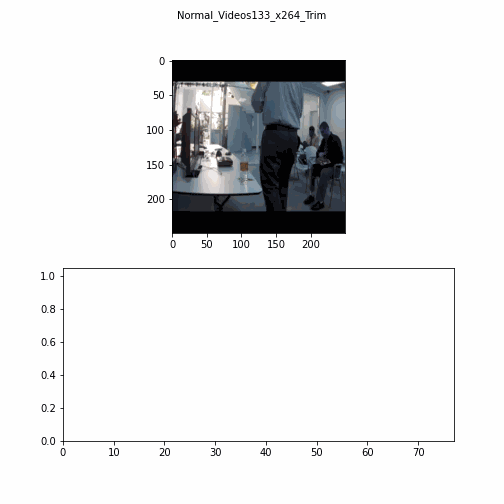

In [ ]:
Img(open('/content/salida/Normal_Videos133_x264_Trim.gif','rb').read())

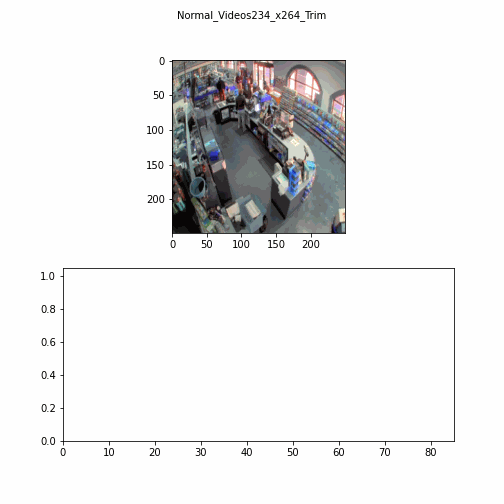

In [ ]:
Img(open('/content/salida/Normal_Videos234_x264_Trim.gif','rb').read())

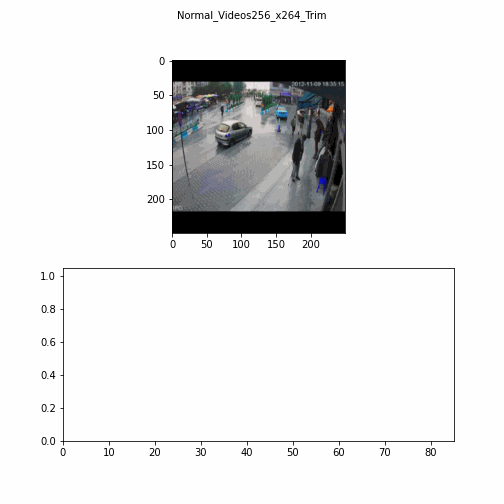

In [ ]:
Img(open('/content/salida/Normal_Videos256_x264_Trim.gif','rb').read())

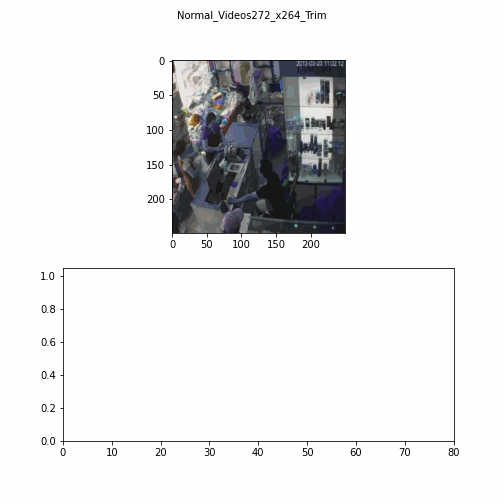

In [ ]:
Img(open('/content/salida/Normal_Videos272_x264_Trim.gif','rb').read())

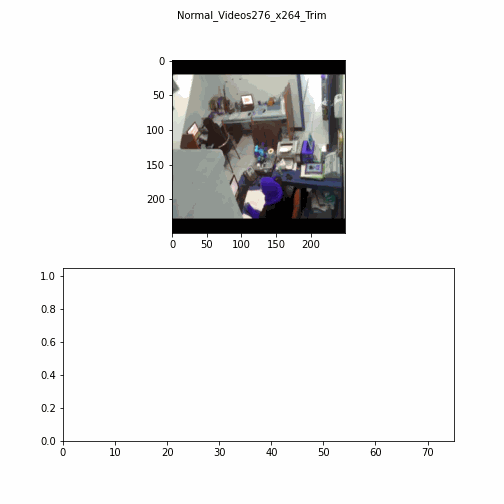

In [ ]:
Img(open('/content/salida/Normal_Videos276_x264_Trim.gif','rb').read())

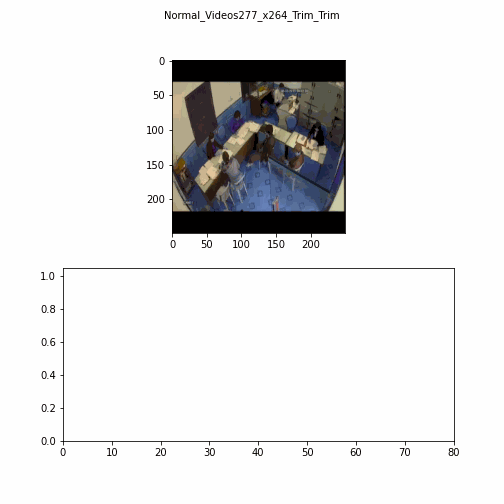

In [ ]:
Img(open('/content/salida/Normal_Videos277_x264_Trim_Trim.gif','rb').read())

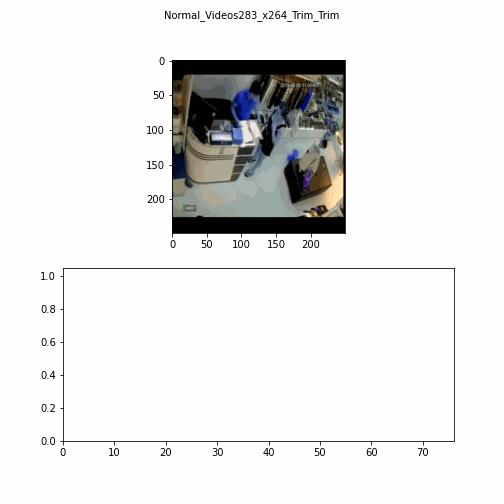

In [ ]:
Img(open('/content/salida/Normal_Videos283_x264_Trim_Trim.gif','rb').read())

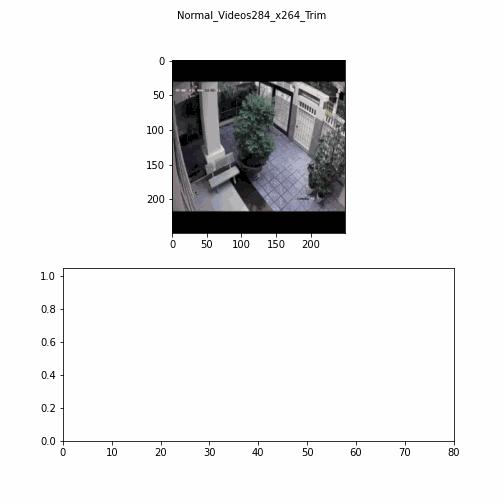

In [ ]:
Img(open('/content/salida/Normal_Videos284_x264_Trim.gif','rb').read())

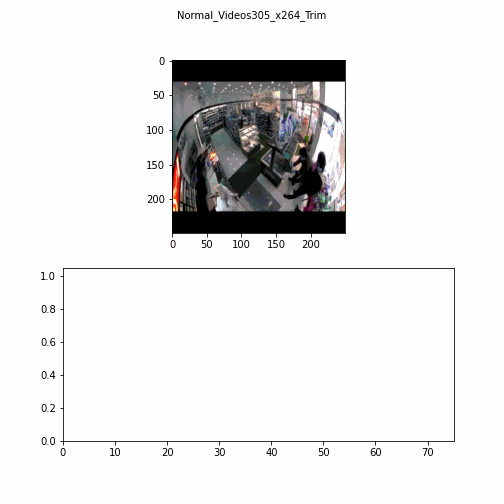

In [ ]:
Img(open('/content/salida/Normal_Videos305_x264_Trim.gif','rb').read())

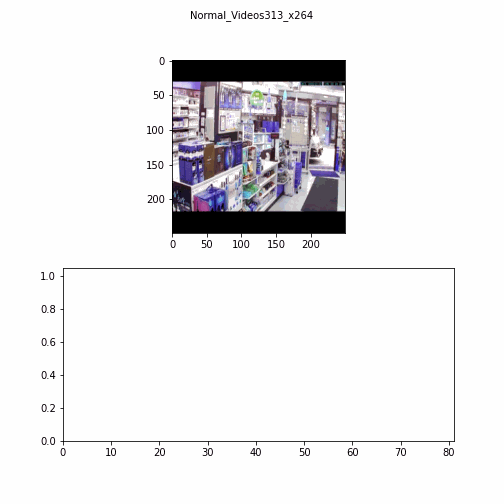

In [ ]:
Img(open('/content/salida/Normal_Videos313_x264.gif','rb').read())

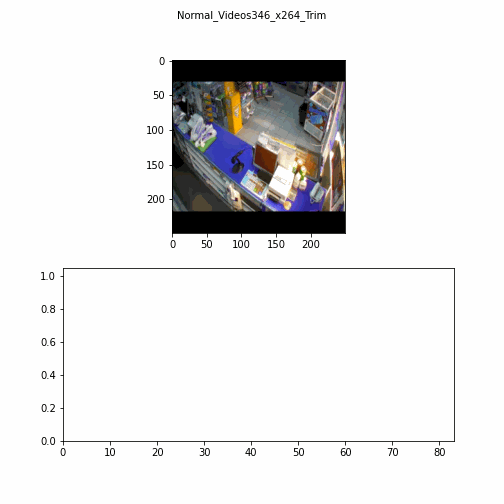

In [ ]:
Img(open('/content/salida/Normal_Videos346_x264_Trim.gif','rb').read())

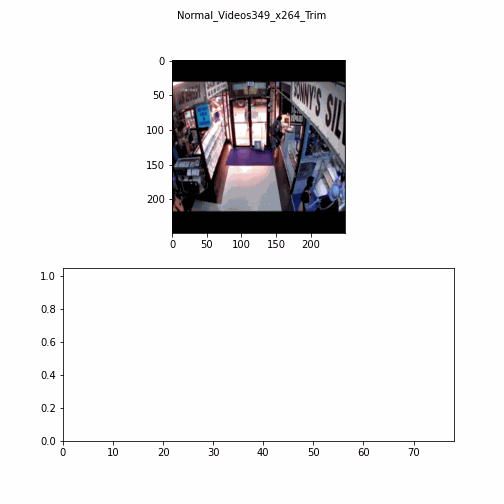

In [ ]:
Img(open('/content/salida/Normal_Videos349_x264_Trim.gif','rb').read())

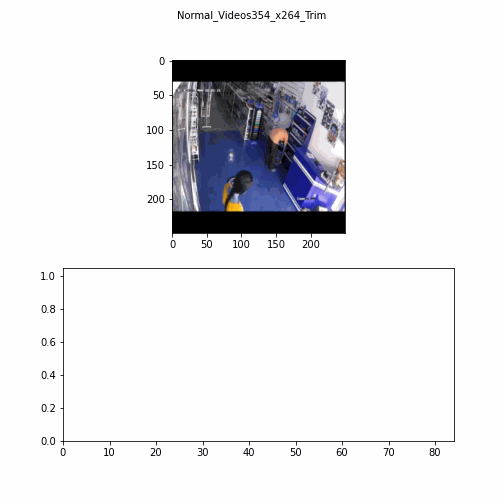

In [ ]:
Img(open('/content/salida/Normal_Videos354_x264_Trim.gif','rb').read())

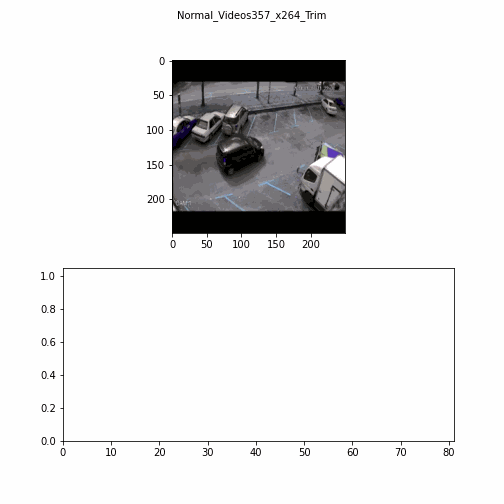

In [ ]:
Img(open('/content/salida/Normal_Videos357_x264_Trim.gif','rb').read())

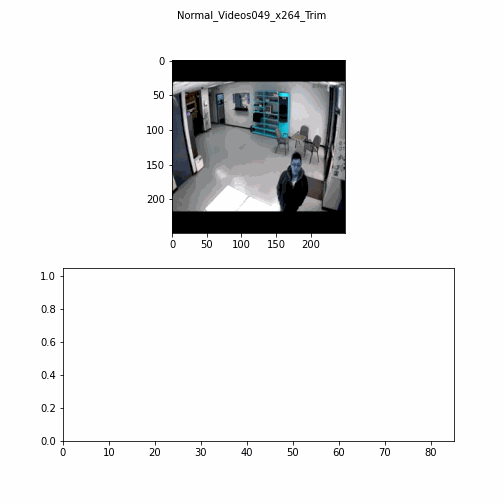

In [ ]:
Img(open('/content/salida2/Normal_Videos049_x264_Trim.gif','rb').read())

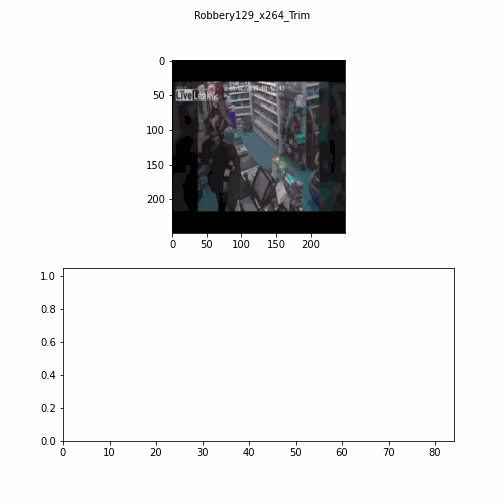

In [ ]:
Img(open('/content/salida2/Robbery129_x264_Trim.gif','rb').read())

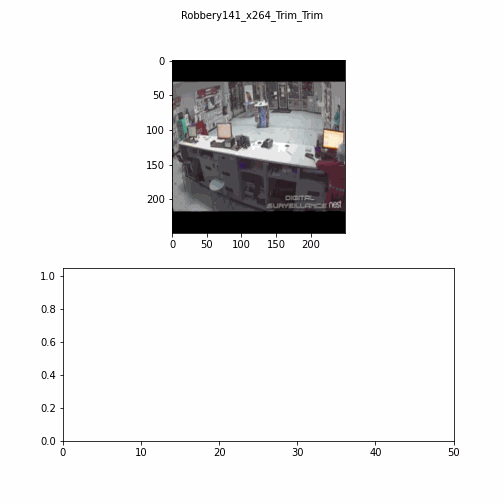

In [ ]:
Img(open('/content/salida2/Robbery141_x264_Trim_Trim.gif','rb').read())

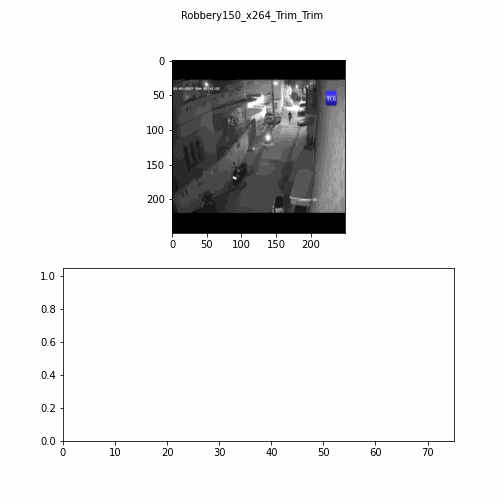

In [ ]:
Img(open('/content/salida2/Robbery150_x264_Trim_Trim.gif','rb').read())

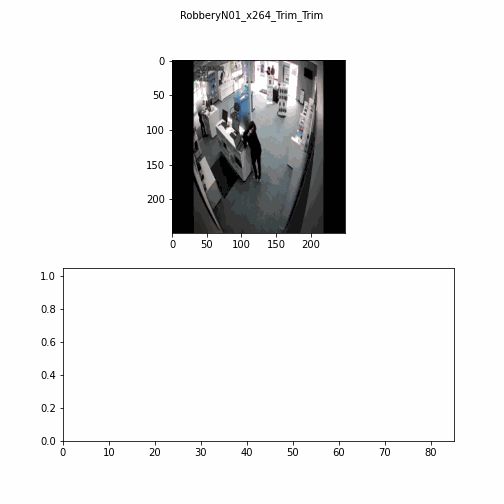

In [ ]:
Img(open('/content/salida2/RobberyN01_x264_Trim_Trim.gif','rb').read())

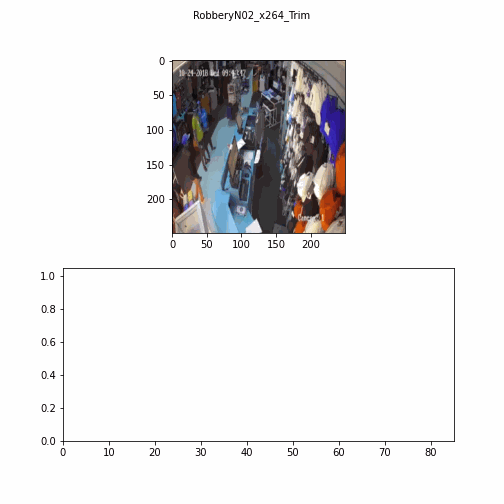

In [ ]:
Img(open('/content/salida2/RobberyN02_x264_Trim.gif','rb').read())

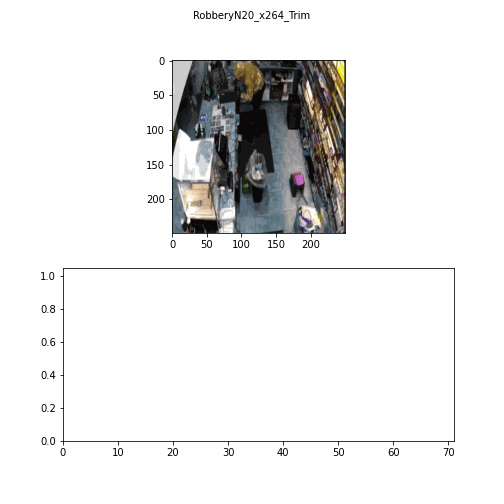

In [ ]:
Img(open('/content/salida2/RobberyN20_x264_Trim.gif','rb').read())

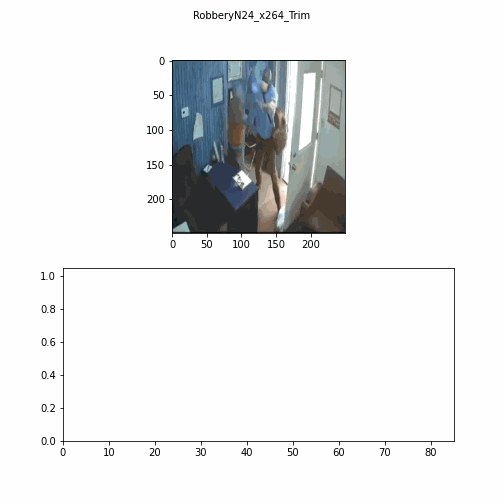

In [ ]:
Img(open('/content/salida2/RobberyN24_x264_Trim.gif','rb').read())

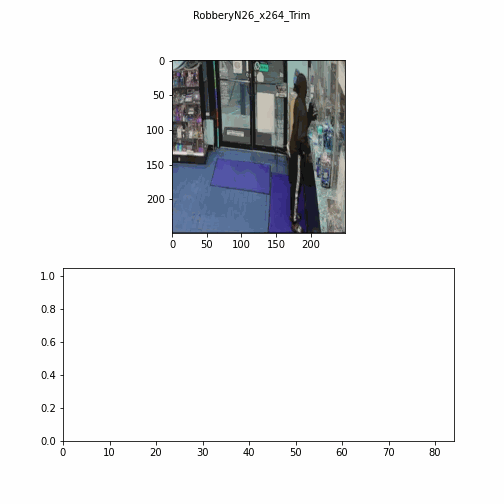

In [ ]:
Img(open('/content/salida2/RobberyN26_x264_Trim.gif','rb').read())

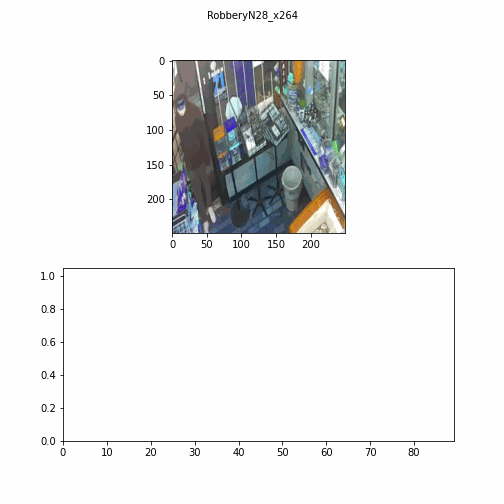

In [ ]:
Img(open('/content/salida2/RobberyN28_x264.gif','rb').read())

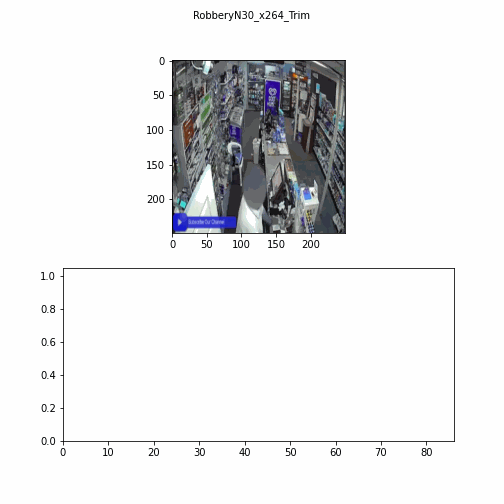

In [ ]:
Img(open('/content/salida2/RobberyN30_x264_Trim.gif','rb').read())

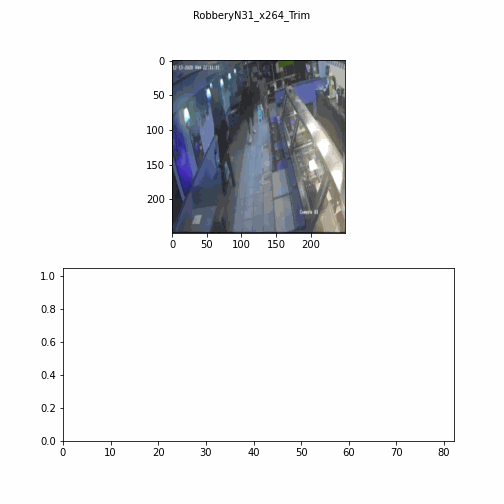

In [ ]:
Img(open('/content/salida2/RobberyN31_x264_Trim.gif','rb').read())

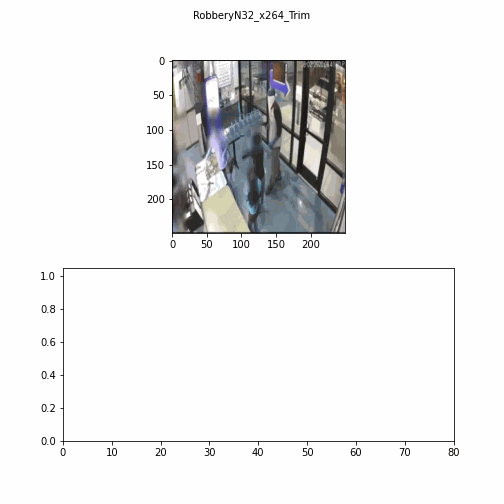

In [ ]:
Img(open('/content/salida2/RobberyN32_x264_Trim.gif','rb').read())

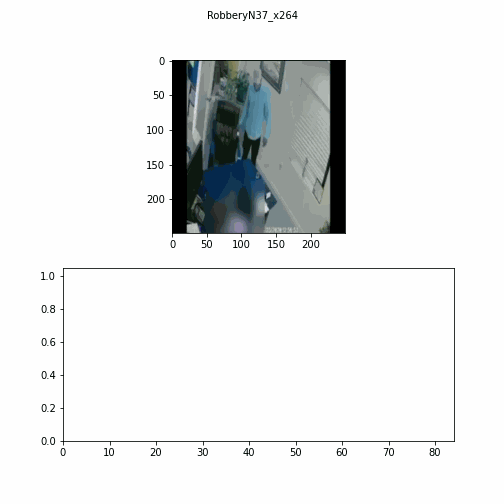

In [ ]:
Img(open('/content/salida2/RobberyN37_x264.gif','rb').read())

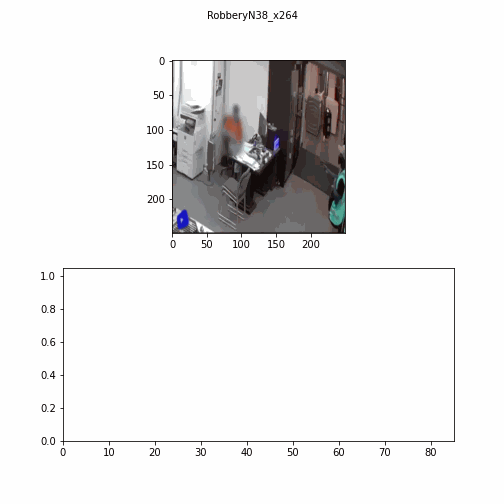

In [ ]:
Img(open('/content/salida2/RobberyN38_x264.gif','rb').read())